In [59]:
import spacy
nlp = spacy.load('en_core_web_sm')
import re
from spacy.matcher import Matcher
import pandas as pd
from collections import defaultdict
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
from wordcloud import WordCloud



In [61]:
with open('jane-eyre.txt', encoding='utf-8') as je:
    text = je.read()

print(len(text))

1041691


In [62]:


# Helper to convert Roman numerals to Arabic numerals
def roman_to_arabic(roman):
    roman_map = {'I': 1, 'V': 5, 'X': 10, 'L': 50, 'C': 100}
    result = 0
    prev_value = 0
    for char in reversed(roman):
        value = roman_map[char]
        if value < prev_value:
            result -= value
        else:
            result += value
        prev_value = value
    return result

def extract_all_chapters(full_text):
    # Regex pattern to find chapter headers like: \nCHAPTER XXIV\n
    pattern = r"\n+CHAPTER ([IVXLCDM]+)\n+"
    
    matches = list(re.finditer(pattern, full_text, flags=re.IGNORECASE))
    chapters = {}

    for i, match in enumerate(matches):
        roman_num = match.group(1).upper()
        arabic_num = roman_to_arabic(roman_num)

        start_index = match.end()
        end_index = matches[i + 1].start() if i + 1 < len(matches) else len(full_text)

        chapter_text = full_text[start_index:end_index].strip()
        chapters[arabic_num] = chapter_text

    return chapters

# Example usage:
chapters_dict = extract_all_chapters(text)
print(chapters_dict[24][:300])  # print first 300 characters of Chapter 24


As I rose and dressed, I thought over what had happened, and wondered
if it were a dream. I could not be certain of the reality till I had
seen Mr. Rochester again, and heard him renew his words of love and
promise.

While arranging my hair, I looked at my face in the glass, and felt it
was no longe


In [63]:
print(chapters_dict.keys())

dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37])


In [64]:
# from spacy.matcher import Matcher
matcher = Matcher(nlp.vocab)

In [65]:
sight_patterns = [
    [{"lemma": "see"}],
    [{"lemma": "look"}],
    [{"lemma": "glance"}],
    [{"lemma": "gaze"}],
    [{"lemma": "eye"}],
    [{"lemma": "watch"}],
    [{"lemma": "stare"}],
    [{"lemma": "peep"}],
    [{"lemma": "behold"}],
    [{"lemma": "view"}],
    [{"lemma": "observe"}],
    [{"lemma": "perceive"}],
    [{"lemma": "discern"}],
    [{"lemma": "regard"}],
    [{"lemma": "scan"}],
    [{"lemma": "survey"}],
    [{"lemma": "note"}],
    [{"lemma": "glimpse"}],
    [{"lemma": "witness"}],
    [{"lemma": "spot"}],
    [{"lemma": "recognize"}],
    [{"lemma": "detect"}],
    [{"lemma": "inspect"}],
    [{"lemma": "examine"}],
    [{"lemma": "contemplate"}],
    [{"lemma": "notice"}],
    [{"lemma": "peer"}],
    [{"lemma": "glower"}],   
    [{"lemma": "ogle"}],    
    [{"lemma": "scan"}],
]

In [66]:
matcher.add("SIGHT", sight_patterns)

In [67]:
doc = nlp(chapters_dict[1])

In [68]:
matches = matcher(doc)
matching_sentences = {}
for match_id, start, end in matches:
    sentence = doc[start].sent
    label = nlp.vocab.strings[match_id]
    if sentence not in matching_sentences:
        matching_sentences[sentence] = {"SIGHT": False}
    matching_sentences[sentence][label] = True

In [69]:
for sentence, sense in matching_sentences.items():
    if sense["SIGHT"]:
        print(sentence)
        print('----------------------')

The said Eliza, John, and Georgiana were now clustered round their mama
in the drawing-room: she lay reclined on a sofa by the fireside, and
with her darlings about her (for the time neither quarrelling nor
crying) looked perfectly happy.
----------------------
Folds of scarlet drapery shut in my view to the right hand; to the left
were the clear panes of glass, protecting, but not separating me from
the drear November day.
----------------------
The words in these
introductory pages connected themselves with the succeeding vignettes,
and gave significance to the rock standing up alone in a sea of billow
and spray; to the broken boat stranded on a desolate coast; to the cold
and ghastly moon glancing through bars of cloud at a wreck just
sinking.


----------------------
So was the black horned thing seated aloof on a rock, surveying a
distant crowd surrounding a gallows.


----------------------
He gorged himself habitually at table, which
made him bilious, and gave him a dim and blea

In [70]:
hearing_patterns = [
    [{"lemma": "hear"}],
    [{"lemma": "listen"}],
    [{"lemma": "overhear"}],
    [{"lemma": "eavesdrop"}],
    [{"lemma": "perceive"}, {"lower": "sound"}], 
    [{"lemma": "attend"}, {"lower": "to"}],      
    [{"lemma": "catch"}, {"lower": "sound"}],
    [{"lemma": "notice"}, {"lower": "sound"}],
    [{"lemma": "detect"}, {"lower": "sound"}],
    
    [{"lemma": "sound"}],
    [{"lemma": "noise"}],
    [{"lemma": "voice"}],
    [{"lemma": "whisper"}],
    [{"lemma": "murmur"}],
    [{"lemma": "shout"}],
    [{"lemma": "cry"}],
    [{"lemma": "call"}],
    [{"lemma": "speak"}],
    [{"lemma": "utter"}],
    [{"lemma": "declare"}],
    [{"lemma": "remark"}],
    [{"lemma": "say"}],
    [{"lemma": "announce"}],
    [{"lemma": "exclaim"}],
    [{"lemma": "sigh"}],
    [{"lemma": "moan"}],
    [{"lemma": "groan"}],
    [{"lemma": "shriek"}],
    [{"lemma": "yell"}],
    [{"lemma": "scream"}],
    [{"lemma": "hiss"}],
    [{"lemma": "howl"}],
    [{"lemma": "echo"}],
]

In [71]:
sound_noun_patterns = [
    [{"lemma": "sound"}],
    [{"lemma": "noise"}],
    [{"lemma": "voice"}],
    [{"lemma": "whisper"}],
    [{"lemma": "murmur"}],
    [{"lemma": "cry"}],
    [{"lemma": "shout"}],
    [{"lemma": "call"}],
    [{"lemma": "sigh"}],
    [{"lemma": "moan"}],
    [{"lemma": "groan"}],
    [{"lemma": "shriek"}],
    [{"lemma": "yell"}],
    [{"lemma": "scream"}],
    [{"lemma": "hiss"}],
    [{"lemma": "howl"}],
    [{"lemma": "echo"}],
    [{"lemma": "tone"}],
    [{"lemma": "utterance"}],
    [{"lemma": "breath"}],      # often used poetically
    [{"lemma": "speech"}],
    [{"lemma": "dialogue"}],
    [{"lemma": "statement"}],
    [{"lemma": "announcement"}],
    [{"lemma": "rumble"}],
    [{"lemma": "roar"}],
    [{"lemma": "clang"}],
    [{"lemma": "rattle"}],
    [{"lemma": "buzz"}],
    [{"lemma": "hum"}],
    [{"lemma": "din"}],         # literary word for a loud, confusing noise
    [{"lemma": "clatter"}],
    [{"lemma": "bang"}],
    [{"lemma": "blast"}],
    [{"lemma": "chime"}],
    [{"lemma": "toll"}],        # as in "the tolling of the bell"
    [{"lemma": "note"}],        # musical or tonal
    [{"lemma": "melody"}],
    [{"lemma": "tune"}],
    [{"lemma": "strain"}],      # archaic word for a passage of music
    [{"lemma": "discord"}],
]


In [72]:
touch_noun_patterns = [
    [{"lemma": "touch"}],
    [{"lemma": "feel"}],
    [{"lemma": "sensation"}],
    [{"lemma": "contact"}],
    [{"lemma": "pressure"}],
    [{"lemma": "grip"}],
    [{"lemma": "grasp"}],
    [{"lemma": "hold"}],
    [{"lemma": "caress"}],
    [{"lemma": "stroke"}],
    [{"lemma": "embrace"}],
    [{"lemma": "clutch"}],
    [{"lemma": "hug"}],
    [{"lemma": "tap"}],
    [{"lemma": "pat"}],
    [{"lemma": "nudge"}],
    [{"lemma": "brush"}],
    [{"lemma": "press"}],
    [{"lemma": "shiver"}],
    [{"lemma": "tingle"}],
    [{"lemma": "warmth"}],
    [{"lemma": "cold"}],
    [{"lemma": "chill"}],
    [{"lemma": "firmness"}],
    [{"lemma": "softness"}],
    [{"lemma": "roughness"}],
    [{"lemma": "smoothness"}],
    [{"lemma": "texture"}],
]


In [73]:
smell_noun_patterns = [
    [{"lemma": "smell"}],
    [{"lemma": "scent"}],
    [{"lemma": "odor"}],
    [{"lemma": "fragrance"}],
    [{"lemma": "perfume"}],
    [{"lemma": "aroma"}],
    [{"lemma": "stench"}],
    [{"lemma": "reek"}],
    [{"lemma": "whiff"}],
    [{"lemma": "fume"}],
    [{"lemma": "essence"}],
    [{"lemma": "breath"}],      # often used poetically for faint smells
    [{"lemma": "bouquet"}],     # old-fashioned word for a blend of scents
    [{"lemma": "incense"}],
    [{"lemma": "musk"}],
    [{"lemma": "vapour"}],
]


In [74]:
taste_noun_patterns = [
    [{"lemma": "taste"}],
    [{"lemma": "flavor"}],
    [{"lemma": "savor"}],
    [{"lemma": "zest"}],
    [{"lemma": "bitterness"}],
    [{"lemma": "sweetness"}],
    [{"lemma": "saltiness"}],
    [{"lemma": "sourness"}],
    [{"lemma": "spice"}],
    [{"lemma": "aftertaste"}],
    [{"lemma": "palate"}],
    [{"lemma": "tang"}],
    [{"lemma": "pungency"}],
    [{"lemma": "delicacy"}],     # as in rare/tasteful food
    [{"lemma": "richness"}],
    [{"lemma": "piquancy"}],
    [{"lemma": "acidity"}],
    [{"lemma": "sharpness"}],
]


In [75]:
touch_verb_patterns = [
    [{"lemma": "touch"}],
    [{"lemma": "feel"}],
    [{"lemma": "grasp"}],
    [{"lemma": "grip"}],
    [{"lemma": "hold"}],
    [{"lemma": "clutch"}],
    [{"lemma": "caress"}],
    [{"lemma": "stroke"}],
    [{"lemma": "embrace"}],
    [{"lemma": "press"}],
    [{"lemma": "pat"}],
    [{"lemma": "tap"}],
    [{"lemma": "brush"}],
    [{"lemma": "nudge"}],
    [{"lemma": "tap"}],
    [{"lemma": "handle"}],
    [{"lemma": "clasp"}],
    [{"lemma": "shiver"}],
    [{"lemma": "tremble"}],
    [{"lemma": "tingle"}],
    [{"lemma": "rub"}],
    [{"lemma": "grate"}],
    [{"lemma": "caress"}],
    [{"lemma": "stroke"}],
]


In [76]:
smell_verb_patterns = [
    [{"lemma": "smell"}],
    [{"lemma": "sniff"}],
    [{"lemma": "inhale"}],
    [{"lemma": "breathe"}],
    [{"lemma": "reek"}],
    [{"lemma": "waft"}],       # can be used for smells moving through air
    [{"lemma": "emit"}],       # e.g., "the flower emitted a scent"
    [{"lemma": "exude"}],
    [{"lemma": "permeate"}],
    [{"lemma": "linger"}],     # used with smells a lot
    [{"lemma": "scent"}],      # can be both verb and noun
    [{"lemma": "detect"}],     # detect a smell
]


In [77]:
taste_verb_patterns = [
    [{"lemma": "taste"}],
    [{"lemma": "savor"}],
    [{"lemma": "lick"}],
    [{"lemma": "chew"}],
    [{"lemma": "swallow"}],
    [{"lemma": "bite"}],
    [{"lemma": "nibble"}],
    [{"lemma": "devour"}],
    [{"lemma": "feast"}],
    [{"lemma": "sample"}],
    [{"lemma": "consume"}],
    [{"lemma": "ingest"}],
    [{"lemma": "relish"}],
    [{"lemma": "gulp"}],
    [{"lemma": "spit"}],
    [{"lemma": "sip"}],
    [{"lemma": "gorge"}],
]


In [78]:
# import pandas as pd
# from collections import defaultdict

In [79]:
matcher.add("SOUND", hearing_patterns)
matcher.add("SOUND", sound_noun_patterns)

In [80]:
sight_noun_patterns = [
    [{"lemma": "sight"}],
    [{"lemma": "vision"}],
    [{"lemma": "view"}],
    [{"lemma": "scene"}],
    [{"lemma": "appearance"}],
    [{"lemma": "glimpse"}],
    [{"lemma": "look"}],
    [{"lemma": "gaze"}],
    [{"lemma": "glance"}],
    [{"lemma": "stare"}],
    [{"lemma": "watch"}],
    [{"lemma": "observation"}],
    [{"lemma": "eye"}],
    [{"lemma": "spectacle"}],
    [{"lemma": "shape"}],
    [{"lemma": "form"}],
    [{"lemma": "figure"}],
    [{"lemma": "image"}],
    [{"lemma": "vision"}],
    [{"lemma": "light"}],
    [{"lemma": "shadow"}],
    [{"lemma": "outline"}],
    [{"lemma": "aspect"}],
    [{"lemma": "vista"}],
    [{"lemma": "prospect"}],   # often used for landscape views
    [{"lemma": "appearance"}],
]

In [81]:
matcher.add("SIGHT", sight_noun_patterns)

In [82]:
match_data = []
chapter_number = 1
matches = matcher(doc)
for match_id, start, end in matches:
    span = doc[start:end]
    sentence = span.sent
    label = nlp.vocab.strings[match_id]  # e.g., "SIGHT"
    lemma = span[0].lemma_               # take first token’s lemma as representative

    cleaned_sentence = " ".join(sentence.text.strip().split())
    
    match_data.append({
        "chapter": chapter_number,
        "sense": label,
        "lemma": lemma,
        "sentence": cleaned_sentence,
        "sentence_start_char": sentence.start_char,
        "sentence_end_char": sentence.end_char
    })

df = pd.DataFrame(match_data)

In [83]:
df

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,1,SOUND,say,"The said Eliza, John, and Georgiana were now c...",667,905
1,1,SOUND,cry,"The said Eliza, John, and Georgiana were now c...",667,905
2,1,SIGHT,look,"The said Eliza, John, and Georgiana were now c...",667,905
3,1,SOUND,say,"Me, she had dispensed from joining the group; ...",906,1395
4,1,SOUND,hear,"Me, she had dispensed from joining the group; ...",906,1395
5,1,SIGHT,observation,"Me, she had dispensed from joining the group; ...",906,1395
6,1,SIGHT,light,"Me, she had dispensed from joining the group; ...",906,1395
7,1,SOUND,say,“What does Bessie say I have done?”,1395,1430
8,1,SOUND,speak,Be seated somewhere; and until you can speak p...,1580,1654
9,1,SIGHT,view,Folds of scarlet drapery shut in my view to th...,2015,2180


Going to eliminate speak and say. Too much noise

In [84]:
hearing_patterns = [
    [{"lemma": "hear"}],
    [{"lemma": "listen"}],
    [{"lemma": "overhear"}],
    [{"lemma": "eavesdrop"}],
    [{"lemma": "perceive"}, {"lower": "sound"}], 
    [{"lemma": "attend"}, {"lower": "to"}],      
    [{"lemma": "catch"}, {"lower": "sound"}],
    [{"lemma": "notice"}, {"lower": "sound"}],
    [{"lemma": "detect"}, {"lower": "sound"}],
    
    [{"lemma": "sound"}],
    [{"lemma": "noise"}],
    [{"lemma": "voice"}],
    [{"lemma": "whisper"}],
    [{"lemma": "murmur"}],
    [{"lemma": "sigh"}],
    [{"lemma": "moan"}],
    [{"lemma": "hiss"}],
    [{"lemma": "howl"}],
    [{"lemma": "echo"}],
]

In [85]:
sound_noun_patterns = [
    [{"lemma": "sound"}],
    [{"lemma": "noise"}],
    [{"lemma": "voice"}],
    [{"lemma": "whisper"}],
    [{"lemma": "murmur"}],
    [{"lemma": "sigh"}],
    [{"lemma": "moan"}],
    [{"lemma": "groan"}],
    [{"lemma": "shriek"}],
    [{"lemma": "yell"}],
    [{"lemma": "scream"}],
    [{"lemma": "hiss"}],
    [{"lemma": "howl"}],
    [{"lemma": "echo"}],
    [{"lemma": "tone"}],
    [{"lemma": "utterance"}],
    [{"lemma": "breath"}],      # often used poetically
    [{"lemma": "speech"}],
    [{"lemma": "rumble"}],
    [{"lemma": "roar"}],
    [{"lemma": "clang"}],
    [{"lemma": "rattle"}],
    [{"lemma": "buzz"}],
    [{"lemma": "hum"}],
    [{"lemma": "din"}],         # literary word for a loud, confusing noise
    [{"lemma": "clatter"}],
    [{"lemma": "bang"}],
    [{"lemma": "blast"}],
    [{"lemma": "chime"}],
    [{"lemma": "toll"}],        # as in "the tolling of the bell"
    [{"lemma": "note"}],        # musical or tonal
    [{"lemma": "melody"}],
    [{"lemma": "tune"}],
    [{"lemma": "strain"}],      # archaic word for a passage of music
    [{"lemma": "discord"}],
]

In [86]:
# matcher.remove("SOUND")
matcher.add("SOUND", hearing_patterns)
matcher.add("SOUND", sound_noun_patterns)

In [87]:
match_data = []
chapter_number = 1
matches = matcher(doc)
for match_id, start, end in matches:
    span = doc[start:end]
    sentence = span.sent
    label = nlp.vocab.strings[match_id]  # e.g., "SIGHT"
    lemma = span[0].lemma_               # take first token’s lemma as representative

    cleaned_sentence = " ".join(sentence.text.strip().split())
    
    match_data.append({
        "chapter": chapter_number,
        "sense": label,
        "lemma": lemma,
        "sentence": cleaned_sentence,
        "sentence_start_char": sentence.start_char,
        "sentence_end_char": sentence.end_char
    })

df = pd.DataFrame(match_data)

In [88]:
df

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,1,SOUND,say,"The said Eliza, John, and Georgiana were now c...",667,905
1,1,SOUND,cry,"The said Eliza, John, and Georgiana were now c...",667,905
2,1,SIGHT,look,"The said Eliza, John, and Georgiana were now c...",667,905
3,1,SOUND,say,"Me, she had dispensed from joining the group; ...",906,1395
4,1,SOUND,hear,"Me, she had dispensed from joining the group; ...",906,1395
5,1,SIGHT,observation,"Me, she had dispensed from joining the group; ...",906,1395
6,1,SIGHT,light,"Me, she had dispensed from joining the group; ...",906,1395
7,1,SOUND,say,“What does Bessie say I have done?”,1395,1430
8,1,SOUND,speak,Be seated somewhere; and until you can speak p...,1580,1654
9,1,SIGHT,view,Folds of scarlet drapery shut in my view to th...,2015,2180


In [89]:
# import pandas as pd

def extract_sensory_matches(chapters_dict, matcher, nlp):
    match_data = []

    for chapter_number, chapter_text in chapters_dict.items():
        doc = nlp(chapter_text)
        matches = matcher(doc)

        for match_id, start, end in matches:
            span = doc[start:end]
            sentence = span.sent
            label = nlp.vocab.strings[match_id]
            lemma = span[0].lemma_
            cleaned_sentence = " ".join(sentence.text.strip().split())

            match_data.append({
                "chapter": chapter_number,
                "sense": label,
                "lemma": lemma,
                "sentence": cleaned_sentence,
                "sentence_start_char": sentence.start_char,
                "sentence_end_char": sentence.end_char,
            })

    return pd.DataFrame(match_data)


In [90]:
df = extract_sensory_matches(chapters_dict, matcher, nlp)
df.head()

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,1,SOUND,say,"The said Eliza, John, and Georgiana were now c...",667,905
1,1,SOUND,cry,"The said Eliza, John, and Georgiana were now c...",667,905
2,1,SIGHT,look,"The said Eliza, John, and Georgiana were now c...",667,905
3,1,SOUND,say,"Me, she had dispensed from joining the group; ...",906,1395
4,1,SOUND,hear,"Me, she had dispensed from joining the group; ...",906,1395


In [91]:
df.describe()

,chapter,sentence_start_char,sentence_end_char
count,4623.000000,4623.000000,4623.000000
mean,20.761627,16330.273848,16517.527147
std,10.086421,11895.616443,11881.102103
min,1.000000,0.000000,58.000000
25%,13.000000,7171.000000,7343.000000
50%,21.000000,14214.000000,14352.000000
75%,28.000000,22526.500000,22696.500000
max,37.000000,68288.000000,68540.000000


In [92]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4623 entries, 0 to 4622
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   chapter              4623 non-null   int64 
 1   sense                4623 non-null   object
 2   lemma                4623 non-null   object
 3   sentence             4623 non-null   object
 4   sentence_start_char  4623 non-null   int64 
 5   sentence_end_char    4623 non-null   int64 
dtypes: int64(3), object(3)
memory usage: 216.8+ KB


In [93]:
df

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,1,SOUND,say,"The said Eliza, John, and Georgiana were now c...",667,905
1,1,SOUND,cry,"The said Eliza, John, and Georgiana were now c...",667,905
2,1,SIGHT,look,"The said Eliza, John, and Georgiana were now c...",667,905
3,1,SOUND,say,"Me, she had dispensed from joining the group; ...",906,1395
4,1,SOUND,hear,"Me, she had dispensed from joining the group; ...",906,1395
...,...,...,...,...,...,...
4618,37,SIGHT,see,To learn more about the Project Gutenberg Lite...,64871,65066
4619,37,SIGHT,form,Information about Donations to the Project Gut...,65860,66256
4620,37,SOUND,statement,International donations are gratefully accepte...,67123,67284
4621,37,SIGHT,notice,Project Gutenberg™ eBooks are often created fr...,67923,68105


In [94]:
# import re

def strip_license_from_last_chapter(chapters_dict: dict) -> dict:
    if not chapters_dict:
        return chapters_dict

    license_patterns = [
        r"\*\*\* (START|END) OF (THE )?PROJECT GUTENBERG.*?\*\*\*",  # Common start/end markers
        r"License:.*",  # License marker you used
        r"Information about.*Project Gutenberg",  # A soft catch-all
    ]

    last_key = list(chapters_dict.keys())[-1]
    last_text = chapters_dict[last_key]

    for pattern in license_patterns:
        match = re.search(pattern, last_text, re.IGNORECASE | re.DOTALL)
        if match:
            chapters_dict[last_key] = last_text[:match.start()].strip()
            break

    return chapters_dict

In [95]:
chapters_dict = strip_license_from_last_chapter(chapters_dict)

In [96]:
df = extract_sensory_matches(chapters_dict, matcher, nlp)
df

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,1,SOUND,say,"The said Eliza, John, and Georgiana were now c...",667,905
1,1,SOUND,cry,"The said Eliza, John, and Georgiana were now c...",667,905
2,1,SIGHT,look,"The said Eliza, John, and Georgiana were now c...",667,905
3,1,SOUND,say,"Me, she had dispensed from joining the group; ...",906,1395
4,1,SOUND,hear,"Me, she had dispensed from joining the group; ...",906,1395
...,...,...,...,...,...,...
4604,37,SIGHT,eye,The last letter I received from him drew from ...,49349,49513
4605,37,SOUND,say,I know that a stranger’s hand will write to me...,49514,49661
4606,37,SOUND,call,I know that a stranger’s hand will write to me...,49514,49661
4607,37,SOUND,say,His own words are a pledge of this— “My Master...,49836,49914


In [97]:
matcher.add("SMELL", smell_noun_patterns)
matcher.add("SMELL", smell_verb_patterns)

In [98]:
def extract_single_sense(chapters_dict, matcher, nlp, sense: str) -> pd.DataFrame:
    all_matches = extract_sensory_matches(chapters_dict, matcher, nlp)
    return all_matches[all_matches["sense"] == sense].reset_index(drop=True)

In [99]:
df_smell = extract_single_sense(chapters_dict, matcher, nlp, "SMELL")

In [100]:
df_smell

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,2,SMELL,breathe,Mr. Reed had been dead nine years: it was in t...,5123,5370
1,4,SMELL,breath,“What?” said Mrs. Reed under her breath: her u...,2738,2960
2,4,SMELL,breathe,Having spread the quilt and folded my night-dr...,8695,9290
3,5,SMELL,fume,I saw a universal manifestation of discontent ...,11882,12113
4,7,SMELL,breath,"And before I could draw breath, “I must not fo...",14447,14535
...,...,...,...,...,...,...
93,34,SMELL,linger,But go after him; he is now lingering in the p...,50031,50120
94,35,SMELL,linger,"All this was torture to me—refined, lingering ...",1639,1693
95,36,SMELL,breathe,I breathed again: my blood resumed its flow.,12295,12339
96,37,SMELL,breath,"I stayed my step, almost my breath, and stood ...",2970,3069


In [101]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4609 entries, 0 to 4608
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   chapter              4609 non-null   int64 
 1   sense                4609 non-null   object
 2   lemma                4609 non-null   object
 3   sentence             4609 non-null   object
 4   sentence_start_char  4609 non-null   int64 
 5   sentence_end_char    4609 non-null   int64 
dtypes: int64(3), object(3)
memory usage: 216.2+ KB
None


In [102]:
df_smell.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 98 entries, 0 to 97
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   chapter              98 non-null     int64 
 1   sense                98 non-null     object
 2   lemma                98 non-null     object
 3   sentence             98 non-null     object
 4   sentence_start_char  98 non-null     int64 
 5   sentence_end_char    98 non-null     int64 
dtypes: int64(3), object(3)
memory usage: 4.7+ KB


In [103]:
df.index

RangeIndex(start=0, stop=4609, step=1)

In [104]:
df_smell.index

RangeIndex(start=0, stop=98, step=1)

In [105]:
combined_df = pd.concat([df, df_smell], ignore_index=True)

In [106]:
combined_df = combined_df.reset_index(drop=True)

In [107]:
combined_df

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,1,SOUND,say,"The said Eliza, John, and Georgiana were now c...",667,905
1,1,SOUND,cry,"The said Eliza, John, and Georgiana were now c...",667,905
2,1,SIGHT,look,"The said Eliza, John, and Georgiana were now c...",667,905
3,1,SOUND,say,"Me, she had dispensed from joining the group; ...",906,1395
4,1,SOUND,hear,"Me, she had dispensed from joining the group; ...",906,1395
...,...,...,...,...,...,...
4702,34,SMELL,linger,But go after him; he is now lingering in the p...,50031,50120
4703,35,SMELL,linger,"All this was torture to me—refined, lingering ...",1639,1693
4704,36,SMELL,breathe,I breathed again: my blood resumed its flow.,12295,12339
4705,37,SMELL,breath,"I stayed my step, almost my breath, and stood ...",2970,3069


In [108]:
combined_df = combined_df.sort_values(by="sentence_start_char").reset_index(drop=True)
combined_df

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,3,SIGHT,see,"The next thing I remember is, waking up with a...",0,167
1,16,SOUND,voice,I both wished and feared to see Mr. Rochester ...,0,155
2,16,SIGHT,eye,I both wished and feared to see Mr. Rochester ...,0,155
3,14,SIGHT,see,For several subsequent days I saw little of Mr...,0,58
4,35,SOUND,say,"He did not leave for Cambridge the next day, a...",0,70
...,...,...,...,...,...,...
4702,27,SIGHT,eye,I was hateful in my own eyes.,58237,58266
4703,27,SIGHT,see,"When I got there, I was forced to sit to rest ...",58866,58989
4704,27,SOUND,hear,"When I got there, I was forced to sit to rest ...",58866,58989
4705,27,SOUND,say,I asked for what sum he would take me there; h...,59157,59290


In [109]:
combined_df = combined_df.sort_values(by=["chapter", "sentence_start_char"]).reset_index(drop=True)
combined_df

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,1,SOUND,say,"The said Eliza, John, and Georgiana were now c...",667,905
1,1,SOUND,cry,"The said Eliza, John, and Georgiana were now c...",667,905
2,1,SIGHT,look,"The said Eliza, John, and Georgiana were now c...",667,905
3,1,SOUND,say,"Me, she had dispensed from joining the group; ...",906,1395
4,1,SIGHT,light,"Me, she had dispensed from joining the group; ...",906,1395
...,...,...,...,...,...,...
4702,37,SIGHT,eye,The last letter I received from him drew from ...,49349,49513
4703,37,SOUND,call,I know that a stranger’s hand will write to me...,49514,49661
4704,37,SOUND,say,I know that a stranger’s hand will write to me...,49514,49661
4705,37,SOUND,say,His own words are a pledge of this— “My Master...,49836,49914


In [110]:
taste_noun_patterns = [
    [{"lemma": "taste"}],
    [{"lemma": "flavor"}],
    [{"lemma": "savor"}],
    [{"lemma": "zest"}],
    [{"lemma": "bitterness"}],
    [{"lemma": "sweetness"}],
    [{"lemma": "saltiness"}],
    [{"lemma": "sourness"}],
    [{"lemma": "spice"}],
    [{"lemma": "aftertaste"}],
    [{"lemma": "palate"}],
    [{"lemma": "tang"}],
    [{"lemma": "pungency"}],
    [{"lemma": "delicacy"}],     # as in rare/tasteful food
    [{"lemma": "richness"}],
    [{"lemma": "piquancy"}],
    [{"lemma": "acidity"}],
    [{"lemma": "sharpness"}],
]

In [111]:
taste_verb_patterns = [
    [{"lemma": "taste"}],
    [{"lemma": "savor"}],
    [{"lemma": "lick"}],
    [{"lemma": "chew"}],
    [{"lemma": "swallow"}],
    [{"lemma": "bite"}],
    [{"lemma": "nibble"}],
    [{"lemma": "devour"}],
    [{"lemma": "feast"}],
    [{"lemma": "sample"}],
    [{"lemma": "consume"}],
    [{"lemma": "ingest"}],
    [{"lemma": "relish"}],
    [{"lemma": "gulp"}],
    [{"lemma": "spit"}],
    [{"lemma": "sip"}],
    [{"lemma": "gorge"}],
]

In [112]:
matcher.add('TASTE', taste_noun_patterns)
matcher.add('TASTE', taste_verb_patterns)

In [113]:
df_taste = extract_single_sense(chapters_dict, matcher, nlp, "TASTE")

In [114]:
df_taste

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,1,TASTE,gorge,"He gorged himself habitually at table, which m...",6431,6548
1,3,TASTE,taste,Again I reflected: I scarcely knew what school...,14163,14738
2,4,TASTE,taste,Something of vengeance I had tasted for the fi...,27048,27252
3,5,TASTE,swallow,I saw a universal manifestation of discontent ...,11882,12113
4,5,TASTE,devour,"Ravenous, and now very faint, I devoured a spo...",12790,13066
...,...,...,...,...,...,...
95,34,TASTE,consume,There would be recesses in my mind which would...,45165,45654
96,36,TASTE,delicacy,"They might have said, as I have no doubt they ...",3086,3375
97,37,TASTE,sweetness,"No—I have touched you, heard you, felt the com...",12668,12799
98,37,TASTE,taste,"“His manners, I think, you said are not to you...",25332,25545


In [115]:
def combine_dataframes(df1, df2):
    combined_df = pd.concat([df1, df2], ignore_index=True)
    combined_df = combined_df.sort_values(by=["chapter", "sentence_start_char"]).reset_index(drop=True)
    return combined_df

In [117]:
df_combined = combine_dataframes(combined_df, df_taste)

In [118]:
df_combined

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,1,SOUND,say,"The said Eliza, John, and Georgiana were now c...",667,905
1,1,SOUND,cry,"The said Eliza, John, and Georgiana were now c...",667,905
2,1,SIGHT,look,"The said Eliza, John, and Georgiana were now c...",667,905
3,1,SOUND,say,"Me, she had dispensed from joining the group; ...",906,1395
4,1,SIGHT,light,"Me, she had dispensed from joining the group; ...",906,1395
...,...,...,...,...,...,...
4802,37,SIGHT,eye,The last letter I received from him drew from ...,49349,49513
4803,37,SOUND,call,I know that a stranger’s hand will write to me...,49514,49661
4804,37,SOUND,say,I know that a stranger’s hand will write to me...,49514,49661
4805,37,SOUND,say,His own words are a pledge of this— “My Master...,49836,49914


In [119]:
touch_noun_patterns = [
    [{"lemma": "touch"}],
    [{"lemma": "sensation"}],
    [{"lemma": "contact"}],
    [{"lemma": "pressure"}],
    [{"lemma": "grip"}],
    [{"lemma": "grasp"}],
    [{"lemma": "hold"}],
    [{"lemma": "caress"}],
    [{"lemma": "stroke"}],
    [{"lemma": "embrace"}],
    [{"lemma": "clutch"}],
    [{"lemma": "hug"}],
    [{"lemma": "tap"}],
    [{"lemma": "pat"}],
    [{"lemma": "nudge"}],
    [{"lemma": "brush"}],
    [{"lemma": "press"}],
    [{"lemma": "shiver"}],
    [{"lemma": "tingle"}],
    [{"lemma": "warmth"}],
    [{"lemma": "cold"}],
    [{"lemma": "chill"}],
    [{"lemma": "firmness"}],
    [{"lemma": "softness"}],
    [{"lemma": "roughness"}],
    [{"lemma": "smoothness"}],
    [{"lemma": "texture"}],
]

In [120]:
touch_verb_patterns = [
    [{"lemma": "touch"}],
    [{"lemma": "grasp"}],
    [{"lemma": "grip"}],
    [{"lemma": "hold"}],
    [{"lemma": "clutch"}],
    [{"lemma": "caress"}],
    [{"lemma": "stroke"}],
    [{"lemma": "embrace"}],
    [{"lemma": "press"}],
    [{"lemma": "pat"}],
    [{"lemma": "tap"}],
    [{"lemma": "brush"}],
    [{"lemma": "nudge"}],
    [{"lemma": "tap"}],
    [{"lemma": "handle"}],
    [{"lemma": "clasp"}],
    [{"lemma": "shiver"}],
    [{"lemma": "tremble"}],
    [{"lemma": "tingle"}],
    [{"lemma": "rub"}],
    [{"lemma": "grate"}],
    [{"lemma": "caress"}],
    [{"lemma": "stroke"}],
]

In [121]:
# matcher.remove('TOUCH')
matcher.add('TOUCH', touch_noun_patterns)
matcher.add('TOUCH', touch_verb_patterns)

In [122]:
df_touch = extract_single_sense(chapters_dict, matcher, nlp, "TOUCH")

In [123]:
df_touch

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,1,TOUCH,cold,"We had been wandering, indeed, in the leafless...",52,348
1,1,TOUCH,cold,Nor could I pass unnoticed the suggestion of t...,3082,3510
2,1,TOUCH,cold,The words in these introductory pages connecte...,3683,3990
3,1,TOUCH,tremble,"And I came out immediately, for I trembled at ...",5856,5953
4,1,TOUCH,grasp,but first—” He ran headlong at me: I felt him ...,9937,10052
...,...,...,...,...,...,...
402,37,TOUCH,cold,"He is good and great, but severe; and, for me,...",30080,30146
403,37,TOUCH,caress,"I caressed, in order to soothe him.",31111,31146
404,37,TOUCH,press,To be privileged to put my arms round what I v...,33128,33266
405,37,TOUCH,hold,"I took that dear hand, held it a moment to my ...",40057,40222


In [124]:
df_combined = combine_dataframes(df_combined, df_touch)

In [125]:
df_combined

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,1,TOUCH,cold,"We had been wandering, indeed, in the leafless...",52,348
1,1,SOUND,say,"The said Eliza, John, and Georgiana were now c...",667,905
2,1,SOUND,cry,"The said Eliza, John, and Georgiana were now c...",667,905
3,1,SIGHT,look,"The said Eliza, John, and Georgiana were now c...",667,905
4,1,SOUND,say,"Me, she had dispensed from joining the group; ...",906,1395
...,...,...,...,...,...,...
5209,37,SIGHT,eye,The last letter I received from him drew from ...,49349,49513
5210,37,SOUND,call,I know that a stranger’s hand will write to me...,49514,49661
5211,37,SOUND,say,I know that a stranger’s hand will write to me...,49514,49661
5212,37,SOUND,say,His own words are a pledge of this— “My Master...,49836,49914


In [126]:
df_combined['sense'].unique()

array(['TOUCH', 'SOUND', 'SIGHT', 'TASTE', 'SMELL'], dtype=object)

In [127]:
# Group by sentence and count unique senses
sense_counts = df_combined.groupby('sentence')['sense'].nunique()

# Get sentences that have more than one unique sense
multi_sense_sentences = sense_counts[sense_counts > 1].index

# Filter original dataframe to only those sentences
df_multi_sense = df_combined[df_combined['sentence'].isin(multi_sense_sentences)]
df_multi_sense

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
1,1,SOUND,say,"The said Eliza, John, and Georgiana were now c...",667,905
2,1,SOUND,cry,"The said Eliza, John, and Georgiana were now c...",667,905
3,1,SIGHT,look,"The said Eliza, John, and Georgiana were now c...",667,905
4,1,SOUND,say,"Me, she had dispensed from joining the group; ...",906,1395
5,1,SIGHT,light,"Me, she had dispensed from joining the group; ...",906,1395
...,...,...,...,...,...,...
5193,37,SIGHT,light,He saw nature—he saw books through me; and nev...,45863,46162
5194,37,SIGHT,see,He saw nature—he saw books through me; and nev...,45863,46162
5195,37,SIGHT,see,He saw nature—he saw books through me; and nev...,45863,46162
5196,37,SIGHT,gaze,He saw nature—he saw books through me; and nev...,45863,46162


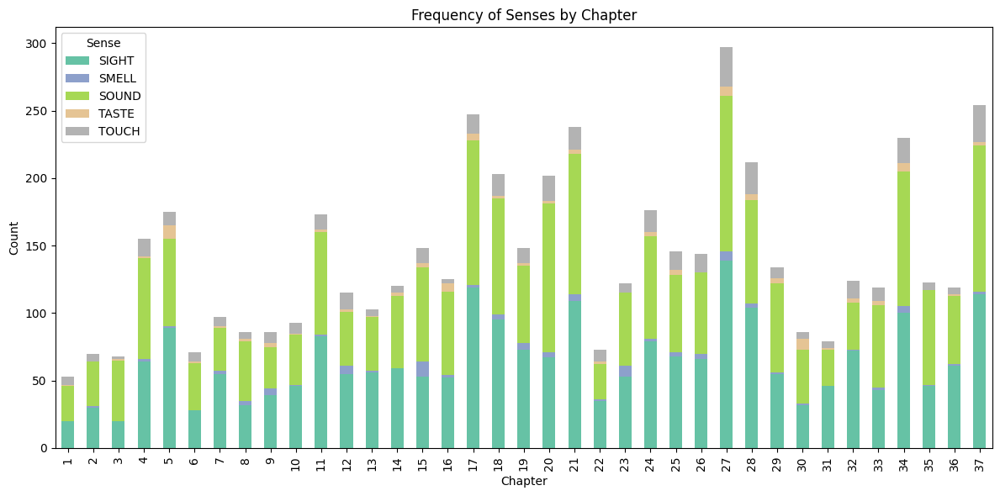

In [128]:
# import seaborn as sns
# import matplotlib.pyplot as plt

# Count occurrences of each sense per chapter
sense_counts = df_combined.groupby(['chapter', 'sense']).size().unstack(fill_value=0)

# Plot
sense_counts.plot(kind='bar', stacked=True, figsize=(12, 6), colormap='Set2')
plt.title('Frequency of Senses by Chapter')
plt.xlabel('Chapter')
plt.ylabel('Count')
plt.legend(title='Sense')
plt.tight_layout()
plt.show()


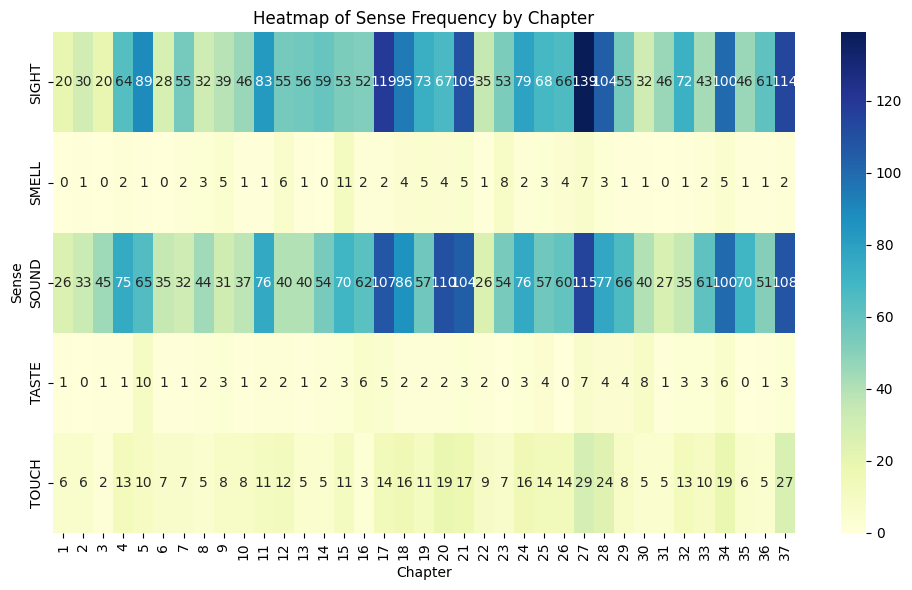

In [129]:
plt.figure(figsize=(10, 6))
sns.heatmap(sense_counts.T, cmap="YlGnBu", annot=True, fmt="d")
plt.title('Heatmap of Sense Frequency by Chapter')
plt.xlabel('Chapter')
plt.ylabel('Sense')
plt.tight_layout()
plt.show()


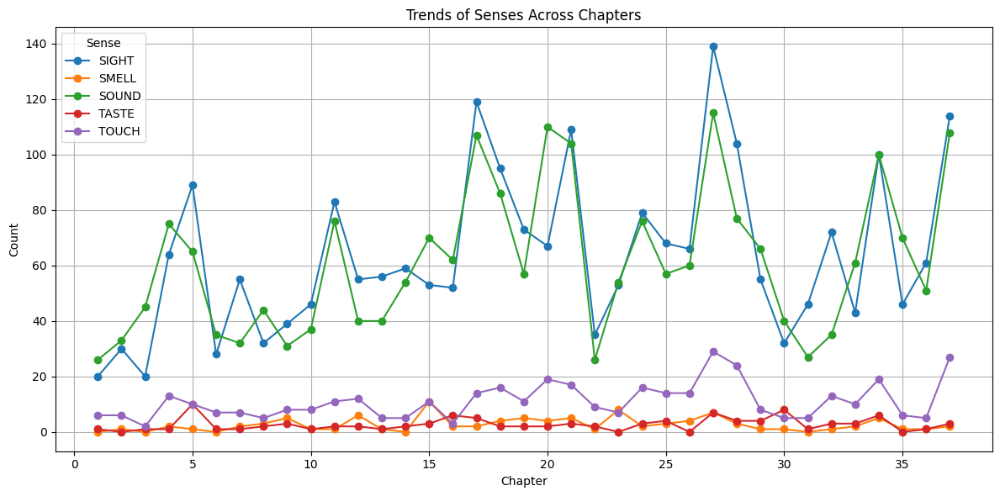

In [130]:
sense_counts.plot(figsize=(12, 6), marker='o')
plt.title('Trends of Senses Across Chapters')
plt.xlabel('Chapter')
plt.ylabel('Count')
plt.legend(title='Sense')
plt.grid(True)
plt.tight_layout()
plt.show()


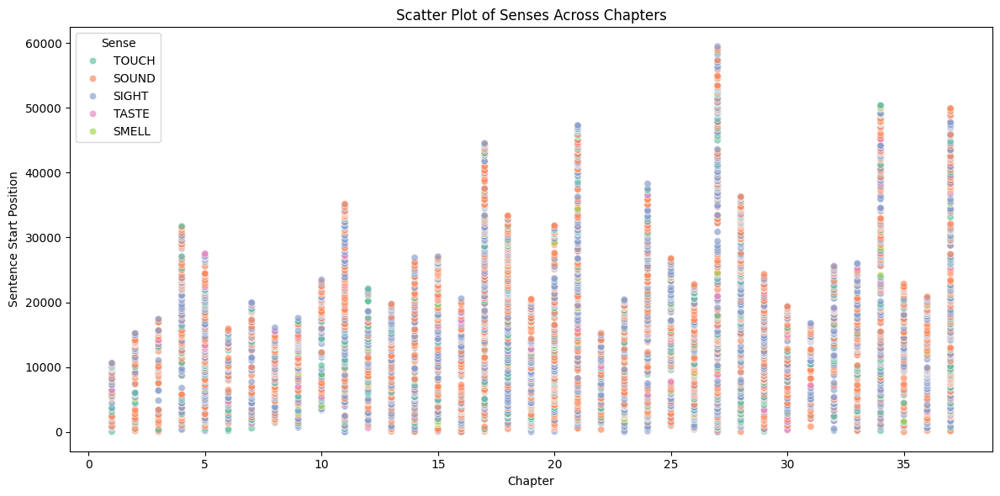

In [131]:
# import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
sns.scatterplot(
    data=df_combined,
    x='chapter',
    y='sentence_start_char',
    hue='sense',
    palette='Set2',
    alpha=0.7
)
plt.title('Scatter Plot of Senses Across Chapters')
plt.xlabel('Chapter')
plt.ylabel('Sentence Start Position')
plt.legend(title='Sense')
plt.tight_layout()
plt.show()


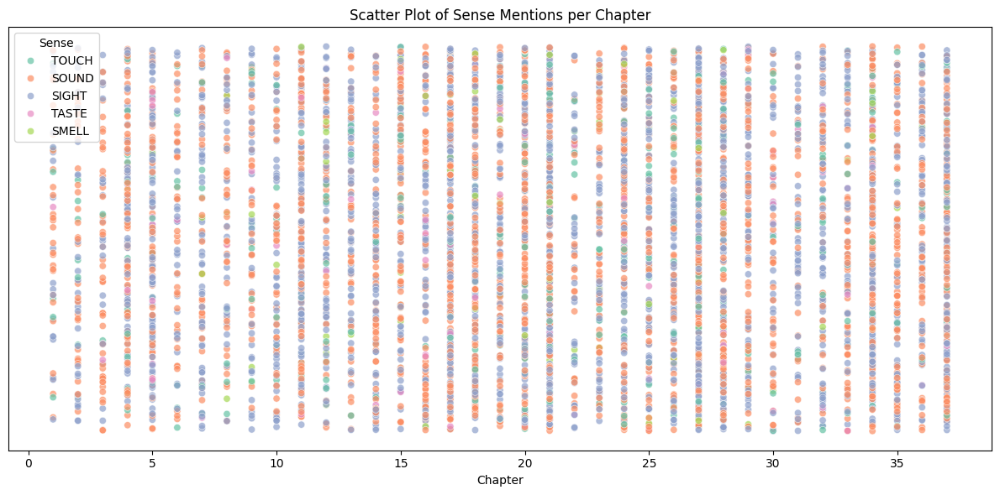

In [132]:
# import numpy as np

plt.figure(figsize=(12, 6))
# Create some jitter for y-axis
df_combined['jitter'] = np.random.uniform(-0.2, 0.2, size=len(df_combined))

sns.scatterplot(
    data=df_combined,
    x='chapter',
    y='jitter',
    hue='sense',
    palette='Set2',
    alpha=0.7
)
plt.yticks([])
plt.title('Scatter Plot of Sense Mentions per Chapter')
plt.xlabel('Chapter')
plt.ylabel('')
plt.legend(title='Sense')
plt.tight_layout()
plt.show()


In [133]:
# import plotly.express as px

fig = px.scatter(
    df_combined,
    x='chapter',
    y='sentence_start_char',
    color='sense',
    hover_data=['lemma', 'sentence'],
    title='Interactive Scatter Plot of Senses Across Chapters',
    labels={'chapter': 'Chapter', 'sentence_start_char': 'Sentence Start Position'},
    opacity=0.7,
    color_discrete_sequence=px.colors.qualitative.Set2
)

fig.update_layout(height=600)
fig.show()


In [134]:
# import plotly.express as px

fig = px.strip(
    df_combined,
    x="sentence_start_char",
    y="sense",
    color="sense",
    hover_data=["chapter", "lemma", "sentence"],
    title="Timeline of Senses Based on Sentence Start Position",
    orientation="h",
    color_discrete_sequence=px.colors.qualitative.Set2
)

fig.update_traces(jitter=0.3, opacity=0.6)
fig.update_layout(
    height=500,
    xaxis_title="Sentence Start Position",
    yaxis_title="Sense",
    showlegend=False
)

fig.show()


In [135]:
chapter_lengths = {k: len(v) for k, v in chapters_dict.items()}
length_df = pd.DataFrame(list(chapter_lengths.items()), columns=['chapter', 'chapter_length'])

In [136]:
sense_counts = df_combined.groupby(['chapter', 'sense']).size().reset_index(name='count')


In [137]:
sense_density = sense_counts.merge(length_df, on='chapter')
sense_density['density'] = sense_density['count'] / sense_density['chapter_length']


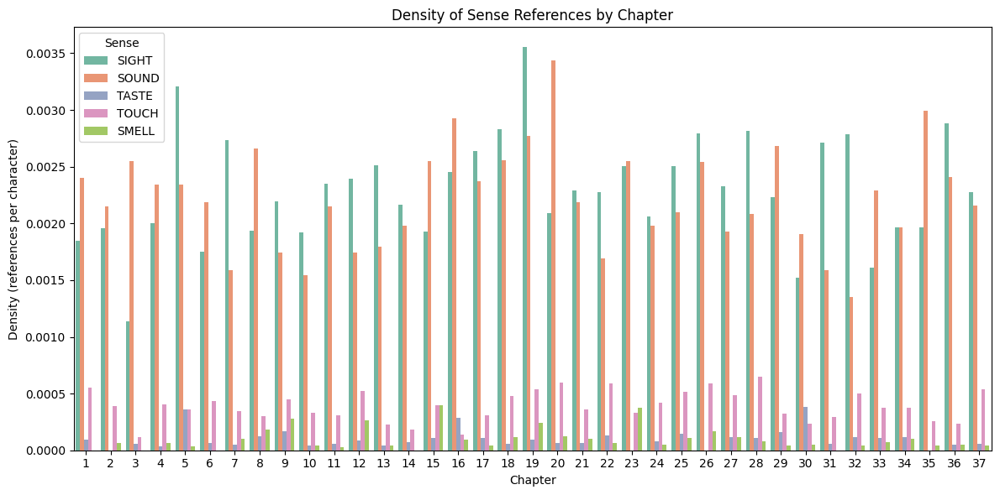

In [138]:
# import seaborn as sns
# import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
sns.barplot(data=sense_density, x='chapter', y='density', hue='sense', palette='Set2')
plt.title('Density of Sense References by Chapter')
plt.xlabel('Chapter')
plt.ylabel('Density (references per character)')
plt.legend(title='Sense')
plt.tight_layout()
plt.show()


In [139]:
# import plotly.express as px

fig = px.bar(
    sense_density,
    x='chapter',
    y='density',
    color='sense',
    title='Density of Sense References by Chapter',
    barmode='group',
    labels={'density': 'References per Character'},
    color_discrete_sequence=px.colors.qualitative.Set2
)
fig.update_layout(xaxis=dict(type='category'))
fig.show()


In [140]:
sense_density['density'] = (sense_density['count'] / sense_density['chapter_length']) * 10000


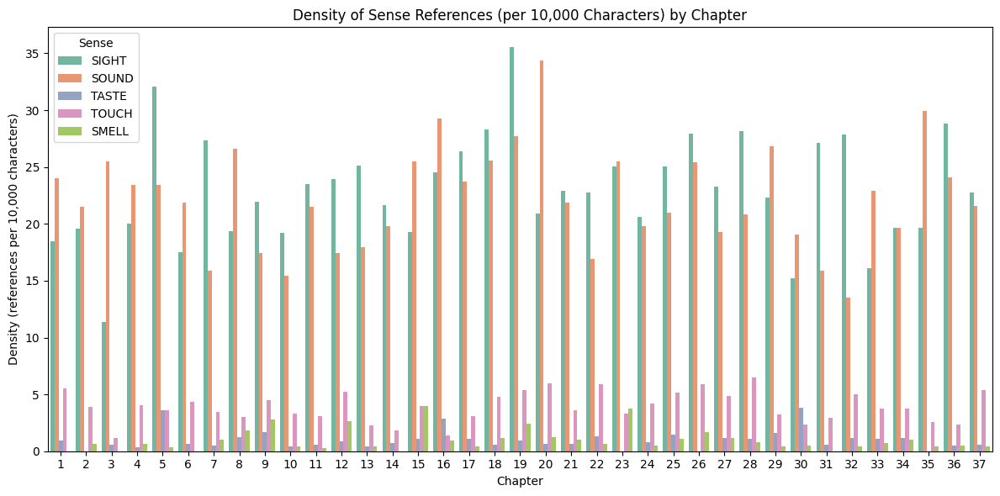

In [141]:
# import seaborn as sns
# import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
sns.barplot(data=sense_density, x='chapter', y='density', hue='sense', palette='Set2')
plt.title('Density of Sense References (per 10,000 Characters) by Chapter')
plt.xlabel('Chapter')
plt.ylabel('Density (references per 10,000 characters)')
plt.legend(title='Sense')
plt.tight_layout()
plt.show()


In [142]:
# import plotly.express as px

fig = px.bar(
    sense_density,
    x='chapter',
    y='density',
    color='sense',
    title='Density of Sense References (per 10,000 Characters) by Chapter',
    barmode='group',
    labels={'density': 'References per 10,000 Characters'},
    color_discrete_sequence=px.colors.qualitative.Set2
)
fig.update_layout(xaxis=dict(type='category'))
fig.show()


In [143]:
# Sum counts for all senses per chapter
total_sense_counts = df_combined.groupby('chapter').size().reset_index(name='total_count')

# Merge with chapter lengths
total_sense_density = total_sense_counts.merge(length_df, on='chapter')

# Calculate density: references per 10,000 characters
total_sense_density['density'] = (total_sense_density['total_count'] / total_sense_density['chapter_length']) * 10000
total_sense_density

,chapter,total_count,chapter_length,density
0,1,53,10839,48.897500
1,2,70,15339,45.635309
2,3,68,17630,38.570618
3,4,155,32013,48.417830
4,5,175,27749,63.065336
5,6,71,16021,44.316834
6,7,97,20115,48.222719
7,8,86,16519,52.061263
8,9,86,17767,48.404345
9,10,93,23967,38.803355


/var/folders/mg/dmr3z4nj5hlck_bwzby0tzy4jxpl0g/T/ipykernel_24967/4226925201.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




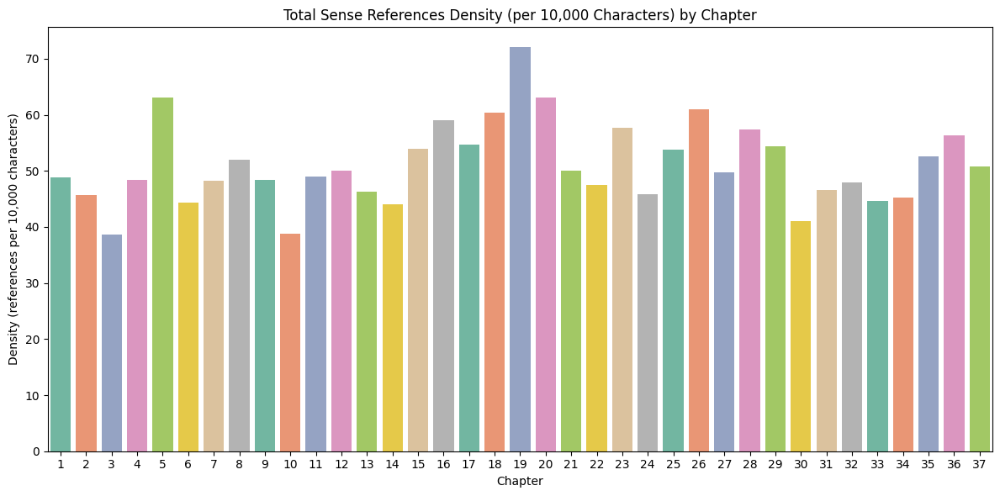

In [144]:
plt.figure(figsize=(12, 6))
sns.barplot(data=total_sense_density, x='chapter', y='density', palette='Set2')
plt.title('Total Sense References Density (per 10,000 Characters) by Chapter')
plt.xlabel('Chapter')
plt.ylabel('Density (references per 10,000 characters)')
plt.tight_layout()
plt.show()


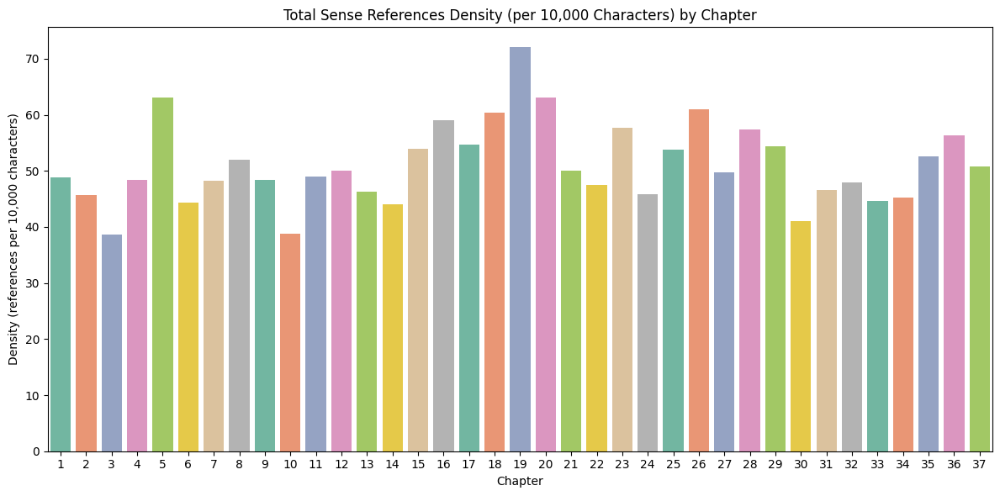

In [145]:
# import matplotlib.pyplot as plt
# import seaborn as sns

plt.figure(figsize=(12, 6))
ax = sns.barplot(
    data=total_sense_density,
    x='chapter',
    y='density',
    hue='chapter',         # give palette a “hue” to map
    palette='Set2',
    dodge=False            # so bars don’t split by hue
)

# remove the now-unnecessary legend
ax.get_legend().remove()

plt.title('Total Sense References Density (per 10,000 Characters) by Chapter')
plt.xlabel('Chapter')
plt.ylabel('Density (references per 10,000 characters)')
plt.tight_layout()
plt.show()


In [146]:
fig = px.bar(
    total_sense_density,
    x='chapter',
    y='density',
    title='Total Sense References Density (per 10,000 Characters) by Chapter',
    labels={'density': 'References per 10,000 Characters'},
    color_discrete_sequence=px.colors.qualitative.Set2
)

fig.update_layout(xaxis=dict(type='category'))
fig.show()


In [147]:
pd.set_option('display.max_colwidth', None)

In [148]:
df_combined

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char,jitter
0,1,TOUCH,cold,"We had been wandering, indeed, in the leafless shrubbery an hour in the morning; but since dinner (Mrs. Reed, when there was no company, dined early) the cold winter wind had brought with it clouds so sombre, and a rain so penetrating, that further outdoor exercise was now out of the question.",52,348,-0.062184
1,1,SOUND,say,"The said Eliza, John, and Georgiana were now clustered round their mama in the drawing-room: she lay reclined on a sofa by the fireside, and with her darlings about her (for the time neither quarrelling nor crying) looked perfectly happy.",667,905,-0.161373
2,1,SOUND,cry,"The said Eliza, John, and Georgiana were now clustered round their mama in the drawing-room: she lay reclined on a sofa by the fireside, and with her darlings about her (for the time neither quarrelling nor crying) looked perfectly happy.",667,905,-0.145331
3,1,SIGHT,look,"The said Eliza, John, and Georgiana were now clustered round their mama in the drawing-room: she lay reclined on a sofa by the fireside, and with her darlings about her (for the time neither quarrelling nor crying) looked perfectly happy.",667,905,0.181868
4,1,SOUND,say,"Me, she had dispensed from joining the group; saying, “She regretted to be under the necessity of keeping me at a distance; but that until she heard from Bessie, and could discover by her own observation, that I was endeavouring in good earnest to acquire a more sociable and childlike disposition, a more attractive and sprightly manner—something lighter, franker, more natural, as it were—she really must exclude me from privileges intended only for contented, happy, little children.”",906,1395,0.019086
...,...,...,...,...,...,...,...
5209,37,SIGHT,eye,"The last letter I received from him drew from my eyes human tears, and yet filled my heart with divine joy: he anticipated his sure reward, his incorruptible crown.",49349,49513,-0.119988
5210,37,SOUND,call,"I know that a stranger’s hand will write to me next, to say that the good and faithful servant has been called at length into the joy of his Lord.",49514,49661,0.120499
5211,37,SOUND,say,"I know that a stranger’s hand will write to me next, to say that the good and faithful servant has been called at length into the joy of his Lord.",49514,49661,-0.154410
5212,37,SOUND,say,"His own words are a pledge of this— “My Master,” he says, “has forewarned me.",49836,49914,-0.019776


In [149]:
df_combined.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5214 entries, 0 to 5213
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   chapter              5214 non-null   int64  
 1   sense                5214 non-null   object 
 2   lemma                5214 non-null   object 
 3   sentence             5214 non-null   object 
 4   sentence_start_char  5214 non-null   int64  
 5   sentence_end_char    5214 non-null   int64  
 6   jitter               5214 non-null   float64
dtypes: float64(1), int64(3), object(3)
memory usage: 285.3+ KB


In [150]:
df_combined = df_combined.drop('jitter', axis=1)

In [151]:
df_combined

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
0,1,TOUCH,cold,"We had been wandering, indeed, in the leafless shrubbery an hour in the morning; but since dinner (Mrs. Reed, when there was no company, dined early) the cold winter wind had brought with it clouds so sombre, and a rain so penetrating, that further outdoor exercise was now out of the question.",52,348
1,1,SOUND,say,"The said Eliza, John, and Georgiana were now clustered round their mama in the drawing-room: she lay reclined on a sofa by the fireside, and with her darlings about her (for the time neither quarrelling nor crying) looked perfectly happy.",667,905
2,1,SOUND,cry,"The said Eliza, John, and Georgiana were now clustered round their mama in the drawing-room: she lay reclined on a sofa by the fireside, and with her darlings about her (for the time neither quarrelling nor crying) looked perfectly happy.",667,905
3,1,SIGHT,look,"The said Eliza, John, and Georgiana were now clustered round their mama in the drawing-room: she lay reclined on a sofa by the fireside, and with her darlings about her (for the time neither quarrelling nor crying) looked perfectly happy.",667,905
4,1,SOUND,say,"Me, she had dispensed from joining the group; saying, “She regretted to be under the necessity of keeping me at a distance; but that until she heard from Bessie, and could discover by her own observation, that I was endeavouring in good earnest to acquire a more sociable and childlike disposition, a more attractive and sprightly manner—something lighter, franker, more natural, as it were—she really must exclude me from privileges intended only for contented, happy, little children.”",906,1395
...,...,...,...,...,...,...
5209,37,SIGHT,eye,"The last letter I received from him drew from my eyes human tears, and yet filled my heart with divine joy: he anticipated his sure reward, his incorruptible crown.",49349,49513
5210,37,SOUND,call,"I know that a stranger’s hand will write to me next, to say that the good and faithful servant has been called at length into the joy of his Lord.",49514,49661
5211,37,SOUND,say,"I know that a stranger’s hand will write to me next, to say that the good and faithful servant has been called at length into the joy of his Lord.",49514,49661
5212,37,SOUND,say,"His own words are a pledge of this— “My Master,” he says, “has forewarned me.",49836,49914


In [152]:
df_combined[2000:2100]

,chapter,sense,lemma,sentence,sentence_start_char,sentence_end_char
2000,18,SIGHT,figure,"Then appeared the magnificent figure of Miss Ingram, clad in white, a long veil on her head, and a wreath of roses round her brow; by her side walked Mr. Rochester, and together they drew near the table.",3276,3479
2001,18,SOUND,call,"At its termination, Colonel Dent and his party consulted in whispers for two minutes, then the Colonel called out— “Bride!”",3684,3808
2002,18,SOUND,whisper,"At its termination, Colonel Dent and his party consulted in whispers for two minutes, then the Colonel called out— “Bride!”",3684,3808
2003,18,SIGHT,scene,Its second rising displayed a more elaborately prepared scene than the last.,3907,3983
2004,18,SIGHT,observe,"The drawing-room, as I have before observed, was raised two steps above the dining-room, and on the top of the upper step, placed a yard or two back within the room, appeared a large marble basin, which I recognised as an ornament of the conservatory—where it usually stood, surrounded by exotics, and tenanted by gold fish—and whence it must have been transported with some trouble, on account of its size and weight.",3984,4404
...,...,...,...,...,...,...
2095,18,SIGHT,see,It was not till after dinner that I saw him again: he then seemed quite at his ease.,21446,21531
2096,18,SIGHT,eye,"His eye wandered, and had no meaning in its wandering: this gave him an odd look, such as I never remembered to have seen.",21646,21768
2097,18,SIGHT,look,"His eye wandered, and had no meaning in its wandering: this gave him an odd look, such as I never remembered to have seen.",21646,21768
2098,18,SIGHT,see,"His eye wandered, and had no meaning in its wandering: this gave him an odd look, such as I never remembered to have seen.",21646,21768


In [153]:
def get_paragraph_spans(paragraphs, doc):
    paragraph_spans = []
    current_start = 0

    for paragraph in paragraphs:
        # Skip empty paragraphs
        if not paragraph.strip():
            continue
        
        # Find the start and end tokens for this paragraph
        start_token = doc.text.index(paragraph.strip(), current_start)
        start_index = doc.text.count('\n', 0, start_token) // 2
        
        paragraph_tokens = [token for token in doc if token.idx >= start_token and 
                             token.idx < (start_token + len(paragraph))]
        
        if paragraph_tokens:
            # Create a Span from the first to the last token of the paragraph
            span = doc[paragraph_tokens[0].i : paragraph_tokens[-1].i + 1]
            paragraph_spans.append(span)
        
        # Update the current start position
        current_start = start_token + len(paragraph)

    return paragraph_spans

In [154]:
def find_paragraphs_with_matches(chapter_text, matcher, nlp):
    paragraphs = chapter_text.split("\n\n")
    doc = nlp(chapter_text)
    paragraph_spans = get_paragraph_spans(paragraphs, doc)
    
    results = []

    for i, span in enumerate(paragraph_spans):
        matches = matcher(span)
        if matches:
            # Get the character offset of the paragraph's start in the full chapter
            char_start = span.start_char
            results.append({
                "paragraph_index": i,
                "char_start": char_start,
                "text": span.text,
                "matches": [(nlp.vocab.strings[match_id], span[start:end].text) 
                            for match_id, start, end in matches]
            })

    return results


In [155]:
ch1_sense_matches = find_paragraphs_with_matches(chapters_dict[1], matcher, nlp)

In [156]:
ch1_sense_matches

[{'paragraph_index': 0,
  'char_start': 0,
  'text': 'There was no possibility of taking a walk that day. We had been\nwandering, indeed, in the leafless shrubbery an hour in the morning;\nbut since dinner (Mrs. Reed, when there was no company, dined early)\nthe cold winter wind had brought with it clouds so sombre, and a rain\nso penetrating, that further outdoor exercise was now out of the\nquestion.',
  'matches': [('TOUCH', 'cold')]},
 {'paragraph_index': 2,
  'char_start': 667,
  'text': 'The said Eliza, John, and Georgiana were now clustered round their mama\nin the drawing-room: she lay reclined on a sofa by the fireside, and\nwith her darlings about her (for the time neither quarrelling nor\ncrying) looked perfectly happy. Me, she had dispensed from joining the\ngroup; saying, “She regretted to be under the necessity of keeping me\nat a distance; but that until she heard from Bessie, and could discover\nby her own observation, that I was endeavouring in good earnest to\nacquire

In [157]:
ch_1_paras = get_paragraph_spans(chapters_dict[1].split('\n\n'), nlp(chapters_dict[1]))

In [158]:
def paragraphs_mentioning_rochester(paragraph_spans):
    rochester_paras = []

    for i, span in enumerate(paragraph_spans):
        for ent in span.ents:
            if ent.label_ == "PERSON" and ent.text.strip().lower().endswith("rochester"):
                rochester_paras.append({
                    "paragraph_index": i,
                    "char_start": span.start_char,
                    "text": span.text,
                    "entity": ent.text
                })
                break  # Only need one match per paragraph

    return rochester_paras

In [159]:
ch_24_paras = get_paragraph_spans(chapters_dict[24].split('\n\n'), nlp(chapters_dict[24]))
ch_24_roch_paras = paragraphs_mentioning_rochester(ch_24_paras)
ch_24_roch_paras

[{'paragraph_index': 0,
  'char_start': 0,
  'text': 'As I rose and dressed, I thought over what had happened, and wondered\nif it were a dream. I could not be certain of the reality till I had\nseen Mr. Rochester again, and heard him renew his words of love and\npromise.',
  'entity': 'Rochester'},
 {'paragraph_index': 5,
  'char_start': 1869,
  'text': '“Mr. Rochester has sent me away to the nursery.”',
  'entity': 'Rochester'},
 {'paragraph_index': 11,
  'char_start': 2666,
  'text': '“Soon to be Jane Rochester,” he added: “in four weeks, Janet; not a day\nmore. Do you hear that?”',
  'entity': 'Jane Rochester'},
 {'paragraph_index': 14,
  'char_start': 3053,
  'text': '“Because you gave me a new name—Jane Rochester; and it seems so\nstrange.”',
  'entity': 'Jane Rochester'},
 {'paragraph_index': 15,
  'char_start': 3128,
  'text': '“Yes, Mrs. Rochester,” said he; “young Mrs. Rochester—Fairfax\nRochester’s girl-bride.”',
  'entity': 'Rochester'},
 {'paragraph_index': 24,
  'char_sta

In [160]:
def find_all_sense_matches(chapters_dict, matcher, nlp):
    all_matches = []

    for chapter_num, chapter_text in chapters_dict.items():
        chapter_matches = find_paragraphs_with_matches(chapter_text, matcher, nlp)
        for match in chapter_matches:
            match["chapter"] = chapter_num
            all_matches.append(match)

    return all_matches

In [161]:
all_sense_paras = find_all_sense_matches(chapters_dict, matcher, nlp)

In [162]:
all_sense_paras[:2]

[{'paragraph_index': 0,
  'char_start': 0,
  'text': 'There was no possibility of taking a walk that day. We had been\nwandering, indeed, in the leafless shrubbery an hour in the morning;\nbut since dinner (Mrs. Reed, when there was no company, dined early)\nthe cold winter wind had brought with it clouds so sombre, and a rain\nso penetrating, that further outdoor exercise was now out of the\nquestion.',
  'matches': [('TOUCH', 'cold')],
  'chapter': 1},
 {'paragraph_index': 2,
  'char_start': 667,
  'text': 'The said Eliza, John, and Georgiana were now clustered round their mama\nin the drawing-room: she lay reclined on a sofa by the fireside, and\nwith her darlings about her (for the time neither quarrelling nor\ncrying) looked perfectly happy. Me, she had dispensed from joining the\ngroup; saying, “She regretted to be under the necessity of keeping me\nat a distance; but that until she heard from Bessie, and could discover\nby her own observation, that I was endeavouring in good ear

In [163]:
def find_all_rochester_mentions(chapters_dict, nlp):
    all_rochester_paras = []

    for chapter_num, chapter_text in chapters_dict.items():
        doc = nlp(chapter_text)
        paragraphs = chapter_text.split("\n\n")
        paragraph_spans = get_paragraph_spans(paragraphs, doc)
        chapter_results = paragraphs_mentioning_rochester(paragraph_spans)
        
        for result in chapter_results:
            result["chapter"] = chapter_num
            all_rochester_paras.append(result)

    return all_rochester_paras

In [164]:
all_rochester_paras = find_all_rochester_mentions(chapters_dict, nlp)

In [165]:
def filter_sense_matches_with_rochester(all_sense_matches, all_rochester_paragraphs):
    # Create a set of (chapter, paragraph_index) for Rochester paragraphs
    roch_locs = {
        (para["chapter"], para["paragraph_index"]) 
        for para in all_rochester_paragraphs
    }

    # Filter sense matches to only those that match Rochester locations
    filtered = [
        match for match in all_sense_matches
        if (match["chapter"], match["paragraph_index"]) in roch_locs
    ]

    return filtered


In [166]:
sense_with_rochester = filter_sense_matches_with_rochester(
    all_sense_paras,
    all_rochester_paras
)

In [167]:
sense_with_rochester[:50]

[{'paragraph_index': 51,
  'char_start': 16260,
  'text': '“Yes,” she said, “it is a pretty place; but I fear it will be getting\nout of order, unless Mr. Rochester should take it into his head to come\nand reside here permanently; or, at least, visit it rather oftener:\ngreat houses and fine grounds require the presence of the proprietor.”',
  'matches': [('SOUND', 'said')],
  'chapter': 11},
 {'paragraph_index': 52,
  'char_start': 16542,
  'text': '“Mr. Rochester!” I exclaimed. “Who is he?”',
  'matches': [('SOUND', 'exclaimed')],
  'chapter': 11},
 {'paragraph_index': 53,
  'char_start': 16586,
  'text': '“The owner of Thornfield,” she responded quietly. “Did you not know he\nwas called Rochester?”',
  'matches': [('SOUND', 'called')],
  'chapter': 11},
 {'paragraph_index': 56,
  'char_start': 16927,
  'text': '“To me? Bless you, child; what an idea! To me! I am only the\nhousekeeper—the manager. To be sure I am distantly related to the\nRochesters by the mother’s side, or at least

In [168]:
df_senses = pd.DataFrame(all_sense_paras)

In [169]:
df_senses.head(10)

,paragraph_index,char_start,text,matches,chapter
0,0,0,"There was no possibility of taking a walk that day. We had been\nwandering, indeed, in the leafless shrubbery an hour in the morning;\nbut since dinner (Mrs. Reed, when there was no company, dined early)\nthe cold winter wind had brought with it clouds so sombre, and a rain\nso penetrating, that further outdoor exercise was now out of the\nquestion.","[(TOUCH, cold)]",1
1,2,667,"The said Eliza, John, and Georgiana were now clustered round their mama\nin the drawing-room: she lay reclined on a sofa by the fireside, and\nwith her darlings about her (for the time neither quarrelling nor\ncrying) looked perfectly happy. Me, she had dispensed from joining the\ngroup; saying, “She regretted to be under the necessity of keeping me\nat a distance; but that until she heard from Bessie, and could discover\nby her own observation, that I was endeavouring in good earnest to\nacquire a more sociable and childlike disposition, a more attractive\nand sprightly manner—something lighter, franker, more natural, as it\nwere—she really must exclude me from privileges intended only for\ncontented, happy, little children.”","[(SOUND, said), (SOUND, crying), (SIGHT, looked), (SOUND, saying), (SOUND, heard), (SIGHT, observation), (SIGHT, lighter)]",1
2,3,1395,“What does Bessie say I have done?” I asked.,"[(SOUND, say)]",1
3,4,1441,"“Jane, I don’t like cavillers or questioners; besides, there is\nsomething truly forbidding in a child taking up her elders in that\nmanner. Be seated somewhere; and until you can speak pleasantly, remain\nsilent.”","[(SOUND, speak)]",1
4,6,2015,"Folds of scarlet drapery shut in my view to the right hand; to the left\nwere the clear panes of glass, protecting, but not separating me from\nthe drear November day. At intervals, while turning over the leaves of\nmy book, I studied the aspect of that winter afternoon. Afar, it\noffered a pale blank of mist and cloud; near a scene of wet lawn and\nstorm-beat shrub, with ceaseless rain sweeping away wildly before a\nlong and lamentable blast.","[(SIGHT, view), (SIGHT, aspect), (SIGHT, scene), (SOUND, blast)]",1
5,7,2458,"I returned to my book—Bewick’s History of British Birds: the\nletterpress thereof I cared little for, generally speaking; and yet\nthere were certain introductory pages that, child as I was, I could not\npass quite as a blank. They were those which treat of the haunts of\nsea-fowl; of “the solitary rocks and promontories” by them only\ninhabited; of the coast of Norway, studded with isles from its southern\nextremity, the Lindeness, or Naze, to the North Cape—","[(SOUND, speaking)]",1
6,9,3082,"Nor could I pass unnoticed the suggestion of the bleak shores of\nLapland, Siberia, Spitzbergen, Nova Zembla, Iceland, Greenland, with\n“the vast sweep of the Arctic Zone, and those forlorn regions of dreary\nspace,—that reservoir of frost and snow, where firm fields of ice, the\naccumulation of centuries of winters, glazed in Alpine heights above\nheights, surround the pole, and concentre the multiplied rigours of\nextreme cold.” Of these death-white realms I formed an idea of my own:\nshadowy, like all the half-comprehended notions that float dim through\nchildren’s brains, but strangely impressive. The words in these\nintroductory pages connected themselves with the succeeding vignettes,\nand gave significance to the rock standing up alone in a sea of billow\nand spray; to the broken boat stranded on a desolate coast; to the cold\nand ghastly moon glancing through bars of cloud at a wreck just\nsinking.\n\n","[(TOUCH, cold), (SIGHT, formed), (TOUCH, cold), (SIGHT, glancing)]",1
7,13,4398,"So was the black horned thing seated aloof on a rock, surveying a\ndistant crowd surrounding a gallows.","[(SIGHT, surveying)]",1
8,16,5287,“Boh! Madam Mope!” cried the voice of John Reed; then he paused: he\nfound the room apparently empty.,"[(SOUND, cried), (SOUND, voice)]",1
9,17,5389,“Where the dickens is she!” he continued. “

In [170]:
df_rochester = pd.DataFrame(all_rochester_paras)

In [171]:
df_rochester_senses = pd.DataFrame(sense_with_rochester)

In [172]:
def clean_texts(l):
    for item in l:
        item["text"] = item["text"].replace("\n", " ")

In [173]:
clean_texts(all_sense_paras)
clean_texts(all_rochester_paras)
clean_texts(sense_with_rochester)


In [174]:
df_senses = pd.DataFrame(all_sense_paras)
df_rochester = pd.DataFrame(all_rochester_paras)
df_rochester_senses = pd.DataFrame(sense_with_rochester)

In [175]:
df_senses.to_csv("sense_paragraphs.csv", index=False)
df_rochester.to_csv("rochester_paragraphs.csv", index=False)
df_rochester_senses.to_csv("sense_with_rochester.csv", index=False)

In [176]:
# from wordcloud import WordCloud
# import matplotlib.pyplot as plt

# Flatten all matched words from the 'matches' field
all_matched_words = [
    match_text.lower()
    for entry in sense_with_rochester
    for _, match_text in entry["matches"]
]


In [177]:
text_for_wordcloud = " ".join(all_matched_words)

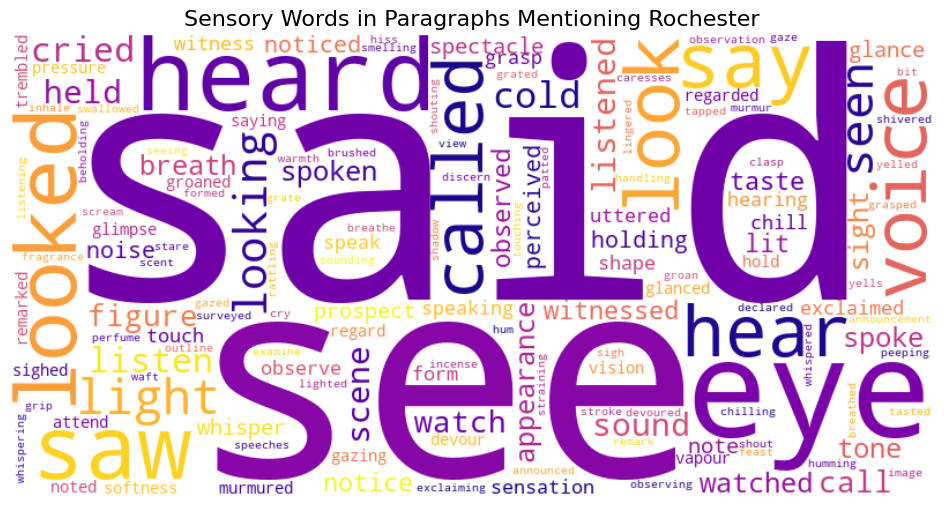

In [178]:
wordcloud = WordCloud(
    width=800,
    height=400,
    background_color='white',
    colormap='plasma'
).generate(text_for_wordcloud)

plt.figure(figsize=(12, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.title("Sensory Words in Paragraphs Mentioning Rochester", fontsize=16)
plt.show()


In [179]:
def extract_lemmas_from_matches(sense_paragraphs, nlp):
    all_lemmas = []

    for para in sense_paragraphs:
        doc = nlp(para["text"])  # Re-run NLP on cleaned paragraph text
        for _, match_text in para["matches"]:
            # Find the lemma of the matched text
            for token in doc:
                if token.text.lower() == match_text.lower():
                    all_lemmas.append(token.lemma_.lower())
                    break  # Just one match per word
    return all_lemmas


In [180]:
all_lemmas = extract_lemmas_from_matches(sense_with_rochester, nlp)


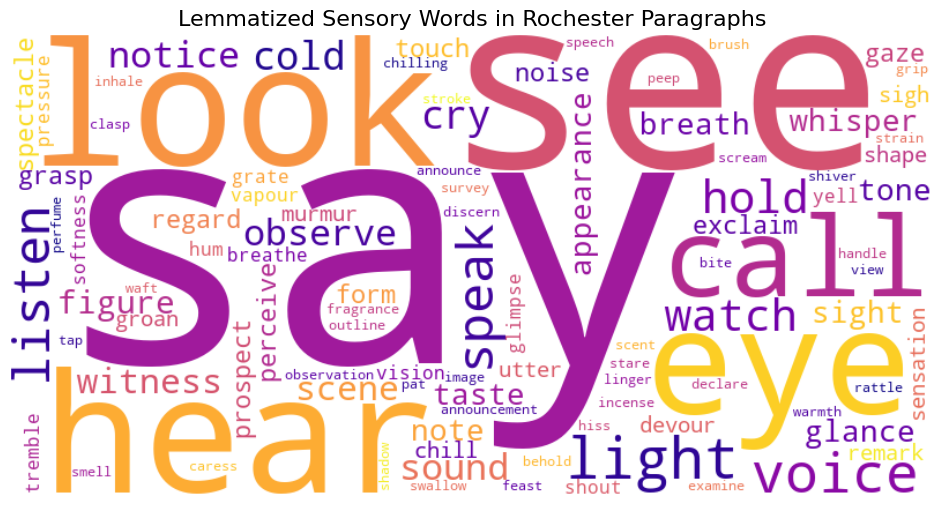

In [181]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

text_for_wordcloud = " ".join(all_lemmas)

wordcloud = WordCloud(
    width=800,
    height=400,
    background_color='white',
    colormap='plasma'
).generate(text_for_wordcloud)

plt.figure(figsize=(12, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.title("Lemmatized Sensory Words in Rochester Paragraphs", fontsize=16)
plt.show()


In [182]:
from collections import Counter

excluded_lemmas = {"say", "speak", "call"}

# Filter them out before counting
lemma_freqs = Counter(
    lemma for lemma in all_lemmas if lemma not in excluded_lemmas
)

# Top 10 most common lemmas, excluding "say"
top_10_lemmas = [lemma for lemma, _ in lemma_freqs.most_common(10)]


In [183]:
from collections import defaultdict

# Initialize: chapter -> lemma -> count
chapter_lemma_counts = defaultdict(lambda: Counter())

for para in sense_with_rochester:
    chapter = para["chapter"]
    doc = nlp(para["text"])
    matched_lemmas = set()

    for _, match_text in para["matches"]:
        for token in doc:
            if token.text.lower() == match_text.lower():
                lemma = token.lemma_.lower()
                if lemma in top_10_lemmas:
                    matched_lemmas.add(lemma)
                break

    for lemma in matched_lemmas:
        chapter_lemma_counts[chapter][lemma] += 1


In [184]:
import pandas as pd

# Convert to DataFrame
data = []
for chapter, lemma_counts in chapter_lemma_counts.items():
    for lemma in top_10_lemmas:
        count = lemma_counts.get(lemma, 0)
        data.append({"Chapter": chapter, "Lemma": lemma, "Count": count})

df = pd.DataFrame(data)


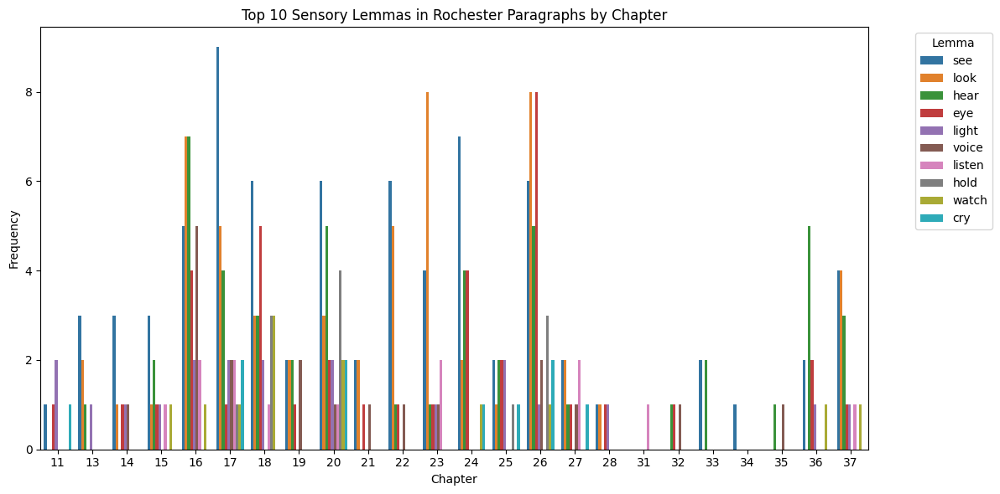

In [185]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
sns.barplot(data=df, x="Chapter", y="Count", hue="Lemma")

plt.title("Top 10 Sensory Lemmas in Rochester Paragraphs by Chapter")
plt.xlabel("Chapter")
plt.ylabel("Frequency")
plt.legend(title="Lemma", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


In [186]:
from collections import defaultdict

# Exclude generic verbs
excluded_lemmas = {"say", "speak", "call"}

# Initialize
sense_lemmas = defaultdict(set)

for para in sense_with_rochester:
    doc = nlp(para["text"])
    for sense, match_text in para["matches"]:
        for token in doc:
            if token.text.lower() == match_text.lower():
                lemma = token.lemma_.lower()
                if lemma not in excluded_lemmas:
                    sense_lemmas[sense.lower()].add(lemma)
                break


In [187]:
# Initialize: chapter -> sense -> count
chapter_sense_counts = defaultdict(lambda: defaultdict(int))

for para in sense_with_rochester:
    chapter = para["chapter"]
    doc = nlp(para["text"])

    for sense, match_text in para["matches"]:
        sense = sense.lower()
        for token in doc:
            if token.text.lower() == match_text.lower():
                lemma = token.lemma_.lower()
                if lemma in sense_lemmas[sense] and lemma not in excluded_lemmas:
                    chapter_sense_counts[chapter][sense] += 1
                break


In [188]:
data = []
for chapter, senses in chapter_sense_counts.items():
    for sense, count in senses.items():
        data.append({"Chapter": chapter, "Sense": sense.capitalize(), "Count": count})

df_senses = pd.DataFrame(data)


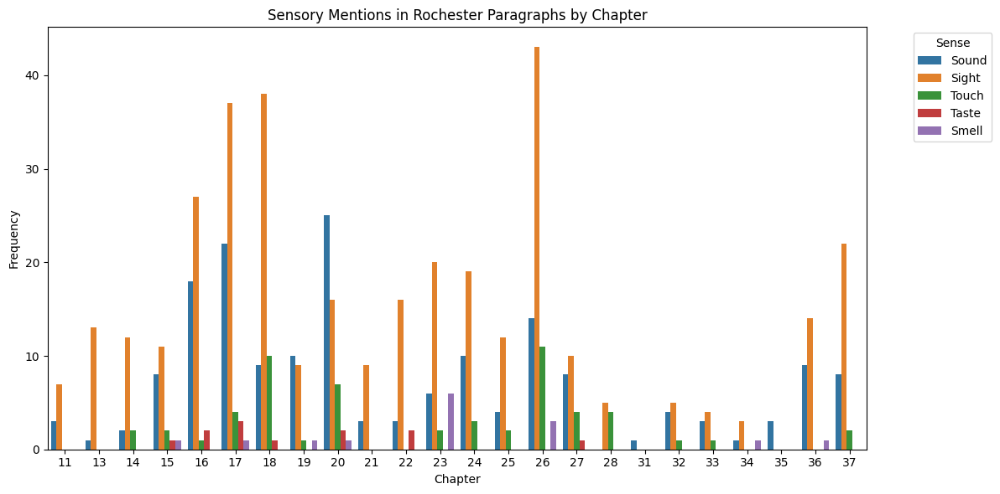

In [189]:
plt.figure(figsize=(12, 6))
sns.barplot(data=df_senses, x="Chapter", y="Count", hue="Sense")

plt.title("Sensory Mentions in Rochester Paragraphs by Chapter")
plt.xlabel("Chapter")
plt.ylabel("Frequency")
plt.legend(title="Sense", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


In [190]:
nlp = spacy.load("en_core_web_lg")

In [202]:
text = chapters_dict[5]

In [203]:
# Get the "food" vector
food_token = nlp("food")[0]

# Load and split Jane Eyre text into paragraphs
paragraphs = [p.strip() for p in text.split("\n\n") if p.strip()]

# Threshold for similarity — you can tune this
SIMILARITY_THRESHOLD = 0.6

# Search paragraphs
matching_paragraphs = []

for para in paragraphs:
    doc = nlp(para)
    if any(food_token.similarity(token) > SIMILARITY_THRESHOLD for token in doc if token.has_vector):
        matching_paragraphs.append(para)

# Print results
print(f"\nFound {len(matching_paragraphs)} paragraphs mentioning food-like concepts:\n")
for para in matching_paragraphs:
    print("-" * 80)
    print(para)


Found 10 paragraphs mentioning food-like concepts:

--------------------------------------------------------------------------------
Five o’clock had hardly struck on the morning of the 19th of January,
when Bessie brought a candle into my closet and found me already up and
nearly dressed. I had risen half-an-hour before her entrance, and had
washed my face, and put on my clothes by the light of a half-moon just
setting, whose rays streamed through the narrow window near my crib. I
was to leave Gateshead that day by a coach which passed the lodge gates
at six A.M. Bessie was the only person yet risen; she had lit a fire in
the nursery, where she now proceeded to make my breakfast. Few children
can eat when excited with the thoughts of a journey; nor could I.
Bessie, having pressed me in vain to take a few spoonfuls of the boiled
milk and bread she had prepared for me, wrapped up some biscuits in a
paper and put them into my bag; then she helped me on with my pelisse
and bonnet, and wr

In [205]:
matching_results = []

for para in paragraphs:
    doc = nlp(para)
    matched_words = [
        token.text for token in doc
        if token.has_vector and not token.is_stop and food_token.similarity(token) > SIMILARITY_THRESHOLD
    ]
    if matched_words:
        matching_results.append((para, matched_words))

# Output
print(f"\nFound {len(matching_results)} paragraphs referencing food-like concepts:\n")
for para, words in matching_results:
    print("-" * 80)
    print(f"🔍 Matched words: {', '.join(words)}\n")
    print(para)


Found 10 paragraphs referencing food-like concepts:

--------------------------------------------------------------------------------
🔍 Matched words: eat

Five o’clock had hardly struck on the morning of the 19th of January,
when Bessie brought a candle into my closet and found me already up and
nearly dressed. I had risen half-an-hour before her entrance, and had
washed my face, and put on my clothes by the light of a half-moon just
setting, whose rays streamed through the narrow window near my crib. I
was to leave Gateshead that day by a coach which passed the lodge gates
at six A.M. Bessie was the only person yet risen; she had lit a fire in
the nursery, where she now proceeded to make my breakfast. Few children
can eat when excited with the thoughts of a journey; nor could I.
Bessie, having pressed me in vain to take a few spoonfuls of the boiled
milk and bread she had prepared for me, wrapped up some biscuits in a
paper and put them into my bag; then she helped me on with my pel

In [209]:
from nltk.corpus import wordnet as wn

def get_related_food_words(word):
    related = set()
    for syn in wn.synsets(word, pos=wn.NOUN):
        for lemma in syn.lemmas():
            related.add(lemma.name().lower().replace('_', ' '))
        for hyponym in syn.hyponyms():
            for lemma in hyponym.lemmas():
                related.add(lemma.name().lower().replace('_', ' '))
    return related

food_words = get_related_food_words("food")
print(sorted(food_words))

['aliment', 'alimentary paste', 'alimentation', 'baked goods', 'beverage', 'breakfast food', 'butter', 'cheese', 'chocolate', 'chyme', 'coconut', 'coconut meat', 'comestible', 'comfort food', 'commissariat', 'convenience food', 'culture medium', 'dika bread', 'drink', 'drinkable', 'eatable', 'edible', 'fare', 'feed', 'fish', 'food', 'food for thought', 'food product', 'foodstuff', 'fresh food', 'fresh foods', 'garden truck', 'green goods', 'green groceries', 'health food', 'intellectual nourishment', 'junk food', 'leftovers', 'loaf', 'manna', 'manna from heaven', 'meat', 'medium', 'micronutrient', 'miraculous food', 'nourishment', 'nutrient', 'nutriment', 'nutrition', 'pabulum', 'pasta', 'potable', 'produce', 'provender', 'provisions', 'seafood', 'slop', 'solid food', 'soul food', 'sustenance', 'viands', 'victual', 'victuals', 'vitellus', 'water', 'yoghourt', 'yoghurt', 'yogurt', 'yolk']


In [210]:
food_words = get_related_food_words("meal")
print(sorted(food_words))

['afternoon tea', 'banquet', 'bite', 'breakfast', 'brunch', 'buffet', 'collation', 'cornmeal', 'dejeuner', 'dinner', 'farina', 'feast', 'indian meal', 'kibble', 'lunch', 'luncheon', 'matzah meal', 'matzo meal', 'matzoh meal', 'meal', 'mess', 'nosh-up', 'oatmeal', 'pea flour', 'picnic', 'pinole', "ploughman's lunch", 'potluck', 'refection', 'repast', 'rolled oats', 'snack', 'spread', 'square meal', 'supper', 'tea', 'teatime', 'tiffin']


In [211]:
food_words = get_related_food_words("porridge")
print(sorted(food_words))

['burgoo', 'gruel', 'hasty pudding', 'oatmeal', 'porridge']
